In [1]:
from PlantReactivityAnalysis.data.signal_dataset import SignalDataset
from PlantReactivityAnalysis.features.features_dataset import FeaturesDataset
from PlantReactivityAnalysis.config import FEATURES_LETTERS_DIR, INTERIM_DATA_DIR, FIGURES_DIR
from PlantReactivityAnalysis.visualization.visualize import plot_signals_with_info

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [3]:
pd.set_option('display.max_rows', None)

# Import Data

In [4]:
norm_letters_signal_dataset_path= INTERIM_DATA_DIR / "norm_letters_signal_dataset.pkl"
signal_dataset= SignalDataset.load(norm_letters_signal_dataset_path)

feat_path= FEATURES_LETTERS_DIR / "features_dataset_norm_letters_ws1_hl1.pkl"
feat_dataset= FeaturesDataset.load(feat_path)

8878 signals have been loaded from C:\Users\alvar\Documents\GitHub\Plant-Reactivity-Analysis\data\interim\norm_letters_signal_dataset.pkl
Dataset loaded from C:\Users\alvar\Documents\GitHub\Plant-Reactivity-Analysis\data\processed\segmented_by_letters\features_dataset_norm_letters_ws1_hl1.pkl. Shape: (8878, 187)


In [5]:
num_signals= len(signal_dataset.features)
signal_dataset.features.shape

(8878, 7)

In [6]:
feat_dataset.features.shape

(8878, 187)

In [7]:
signal_dataset.features.head()

,id_measurement,id_performance,datetime,plant,generation,num_eurythmy,eurythmy_letter
0,1,1,2023-04-29,salad,1,1,A1
1,1,1,2023-04-29,salad,1,1,G1
2,1,1,2023-04-29,salad,1,1,D1
3,1,1,2023-04-29,salad,1,1,A2
4,1,1,2023-04-29,salad,1,1,G2


In [8]:
df= feat_dataset.objective_features
feat_dataset.features.head()

,id_measurement,id_performance,datetime,plant,generation,num_eurythmy,eurythmy_letter,cepstra_1_avg,cepstra_2_avg,cepstra_3_avg,...,flatness_ratio_100,hjorth_mobility,hjorth_complexity,mean,variance,standard_deviation,interquartile_range,skewness,kurtosis,dfa
0,1,1,2023-04-29,salad,1,1,A1,0.739589,0.674924,0.600374,...,0.774433,0.000017,80464.145670,-0.069488,2.080011,1.442224,1.082166,-1.651490,1.428384,1.652581
1,1,1,2023-04-29,salad,1,1,G1,0.756421,0.695534,0.650491,...,0.982800,0.000021,54194.021625,0.579218,0.200783,0.448089,0.144289,-2.380866,4.743071,1.640983
2,1,1,2023-04-29,salad,1,1,D1,0.797132,0.742765,0.701879,...,0.871789,0.000020,59588.992615,-1.019622,0.923799,0.961145,1.515033,-0.104159,-0.900896,1.679972
3,1,1,2023-04-29,salad,1,1,A2,0.765895,0.723631,0.656488,...,0.848300,0.000015,87704.209952,-0.912563,1.830160,1.352834,1.442888,-1.178505,0.668149,1.672634
4,1,1,2023-04-29,salad,1,1,G2,0.719626,0.721916,0.686407,...,0.978600,0.000022,52998.819272,0.371457,0.457155,0.676132,0.577155,-1.348706,0.188683,1.734061


# Flatness Ratio

## First Attempt

In [9]:
indexes = df[(df['flatness_ratio_1000'] > 0.75) & (df['flatness_ratio_500'] > 0.85) & (df['flatness_ratio_100'] > 0.999)].index
print("There is a total of ", len(indexes), " signals that represent the ", round(len(indexes) / float(num_signals) * 100, 2), " % of the dataset")

There is a total of  240  signals that represent the  2.7  % of the dataset


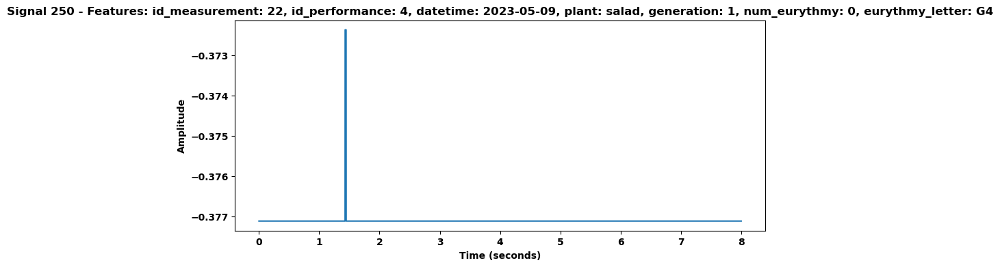

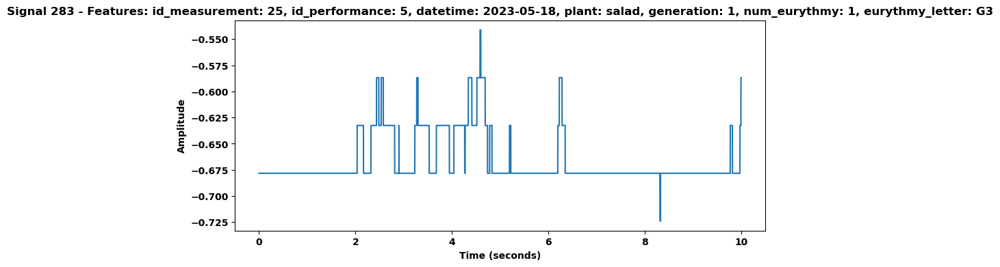

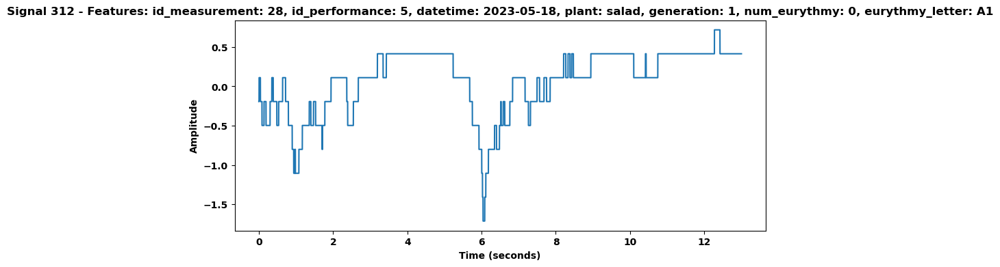

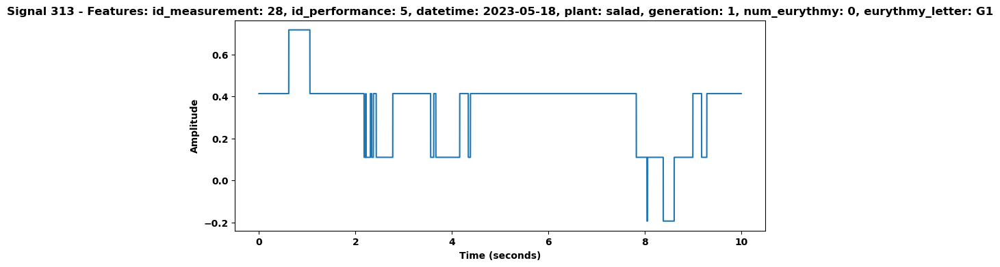

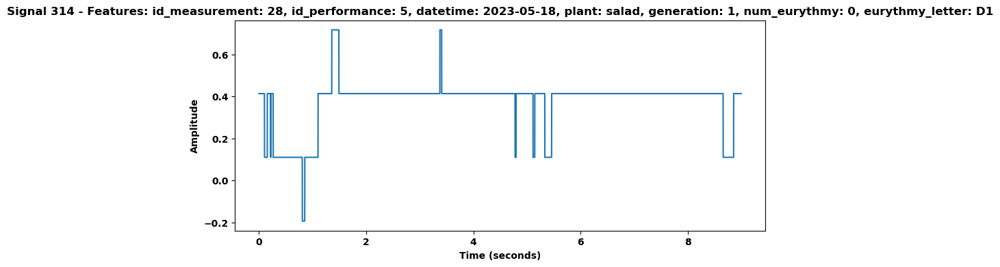

...

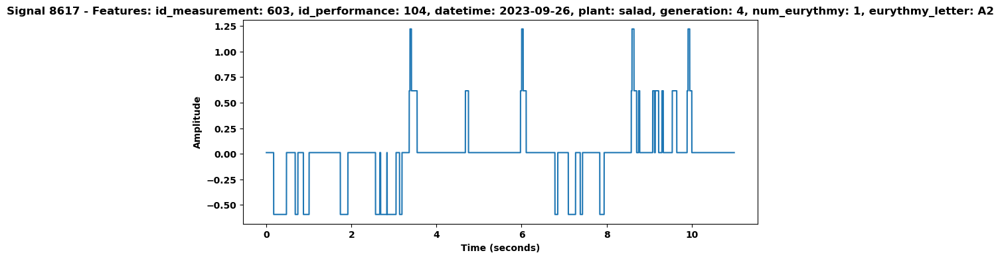

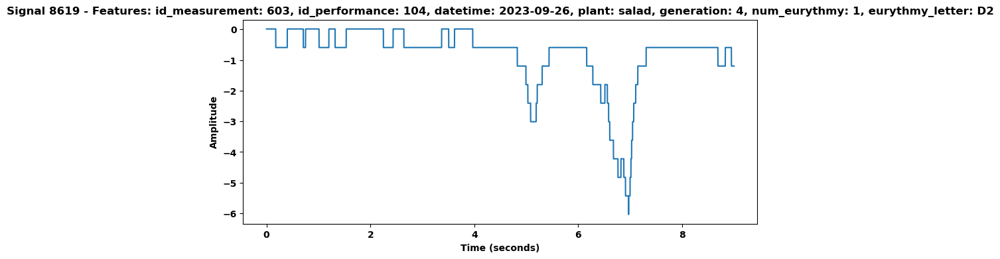

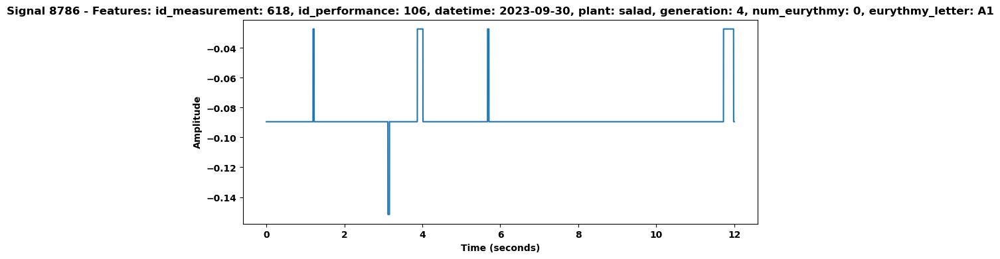

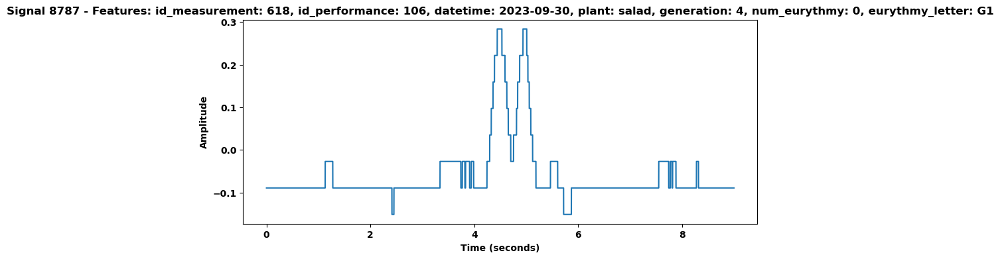

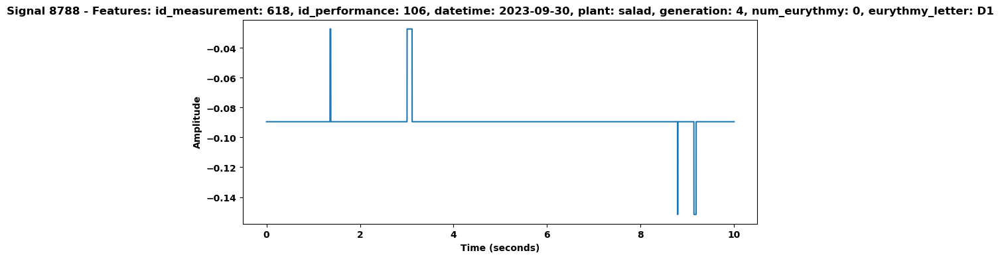

In [10]:
signal_dataset.display_selected_signals(indexes)
indexes_already_shown= indexes

## Second Attempt: Final Rule

In [11]:
indexes = df[(df['flatness_ratio_1000'] > 0.75) | (df['flatness_ratio_500'] > 0.85) | (df['flatness_ratio_100'] > 0.999)].index
print("There is a total of ", len(indexes), " signals that represent the ", round(len(indexes) / float(num_signals) * 100, 2), " % of the dataset")

There is a total of  791  signals that represent the  8.91  % of the dataset


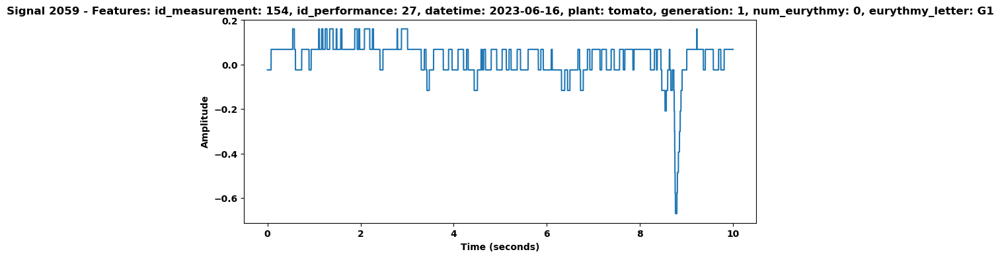

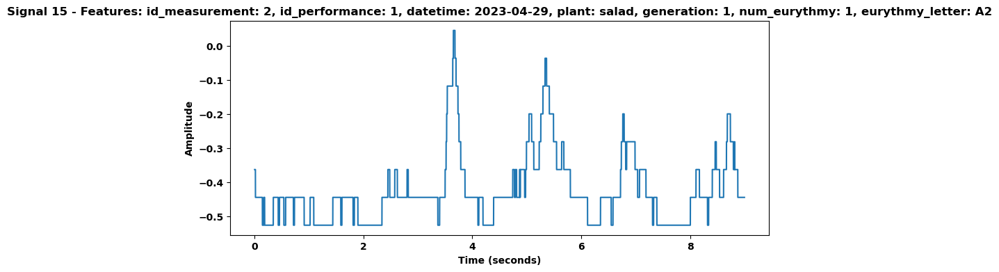

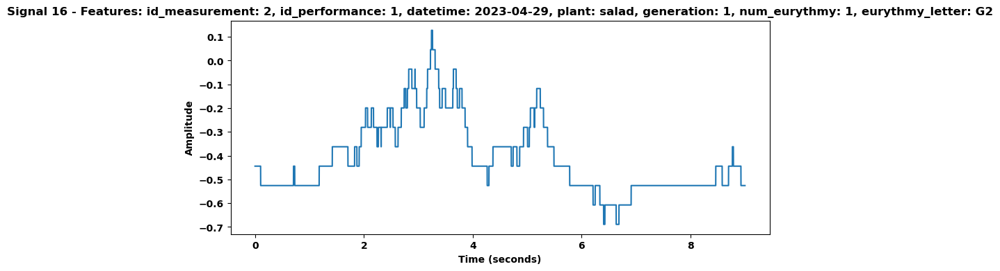

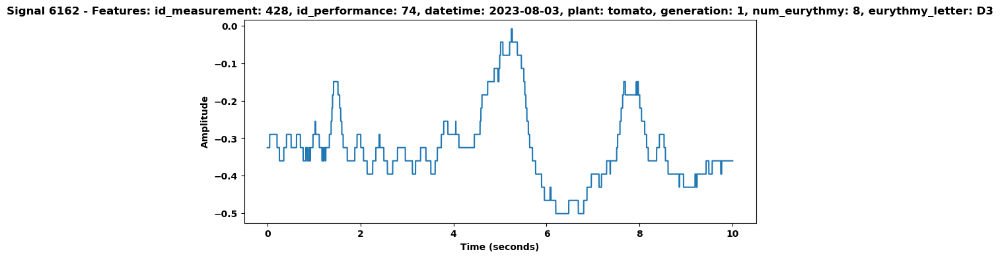

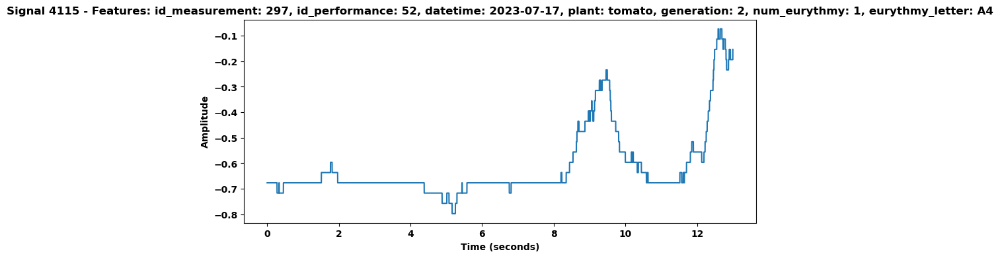

...

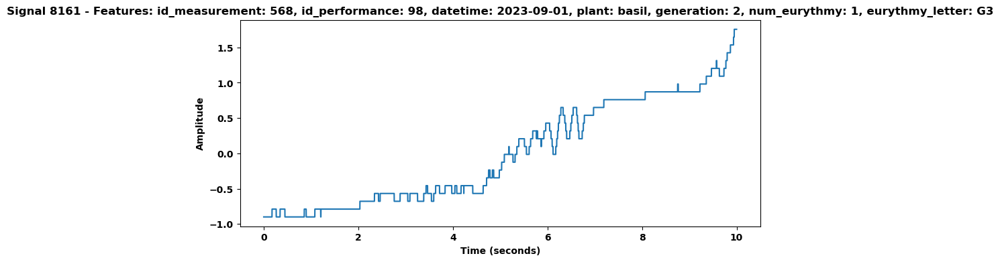

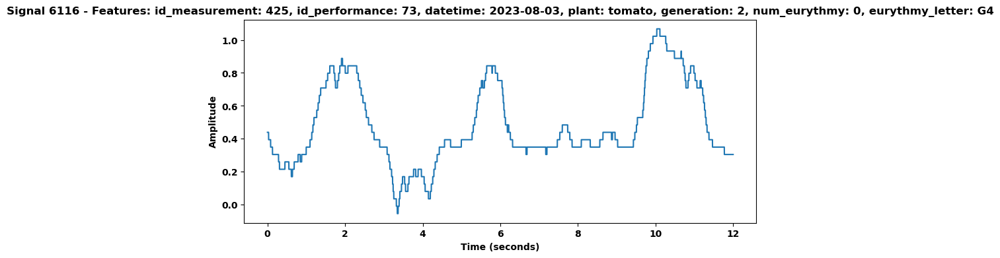

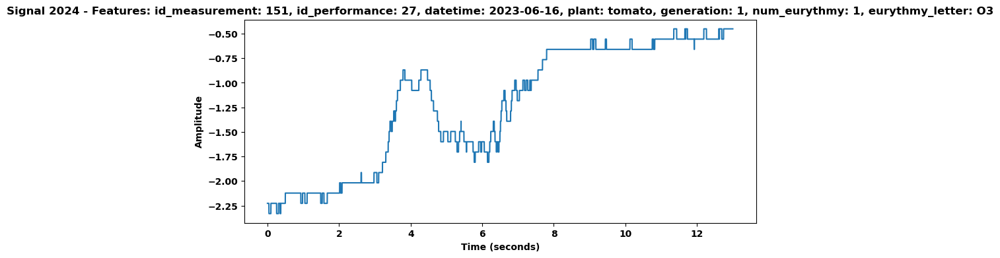

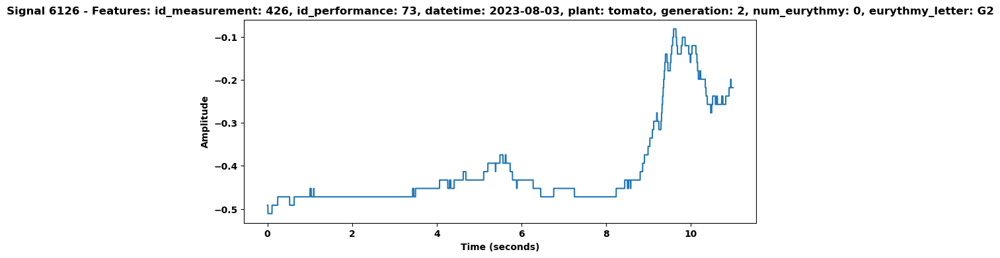

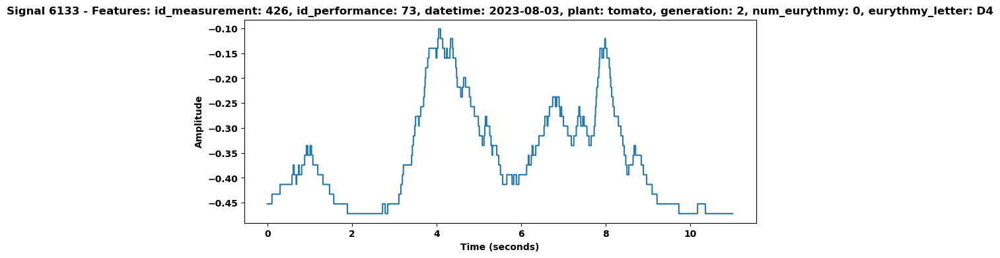

In [12]:
signal_dataset.display_selected_signals(set(indexes)-set(indexes_already_shown))
indexes_already_shown= indexes

## Print Examples

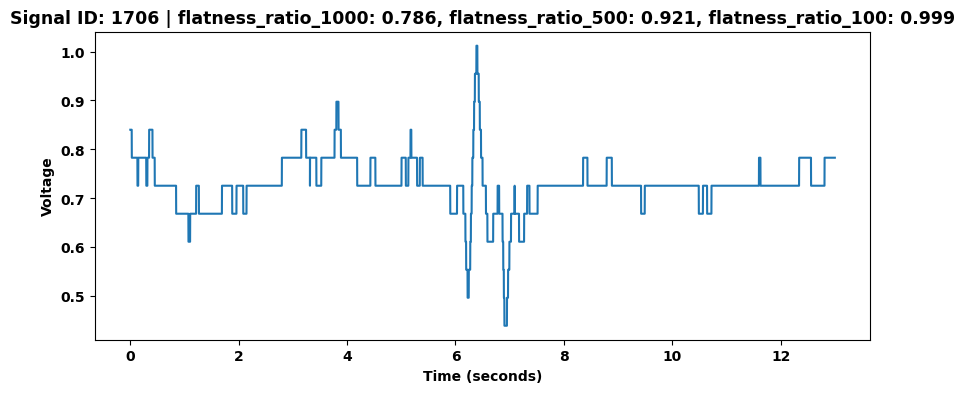

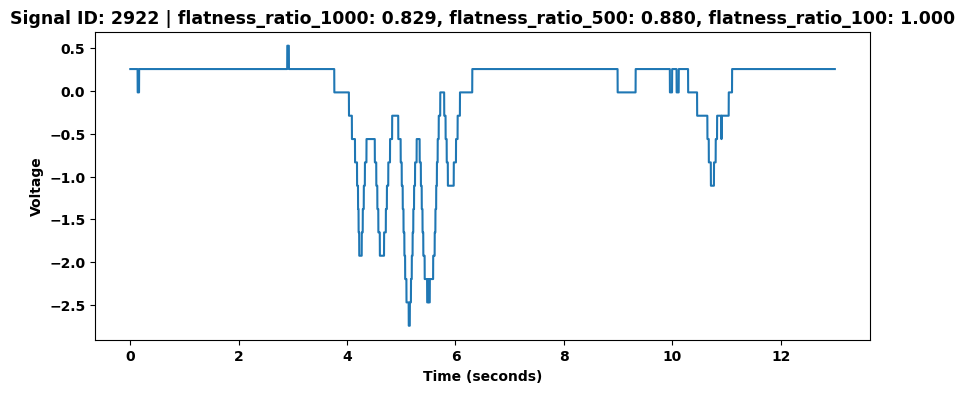

In [13]:
plot_signals_with_info([1706,2922] , signal_dataset.signals, df, ['flatness_ratio_1000','flatness_ratio_500','flatness_ratio_100'], output_folder=FIGURES_DIR)

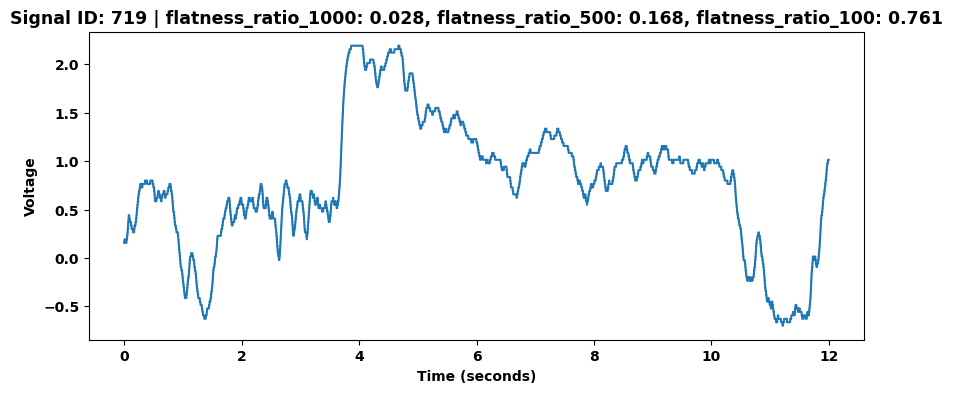

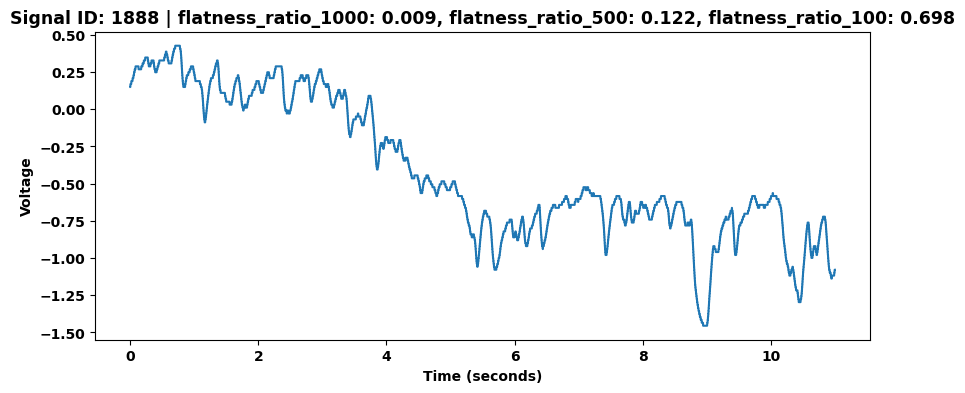

In [14]:
plot_signals_with_info([719,1888], signal_dataset.signals, df, ['flatness_ratio_1000','flatness_ratio_500','flatness_ratio_100'], output_folder=FIGURES_DIR)